In [1]:
import numpy as np
import keras.preprocessing.image

%matplotlib inline
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = 20, 20

Using TensorFlow backend.


In [2]:
x = np.load("../per_class/prep/3band_in.npy")
y = np.load("../per_class/prep/3band_chan1.npy")

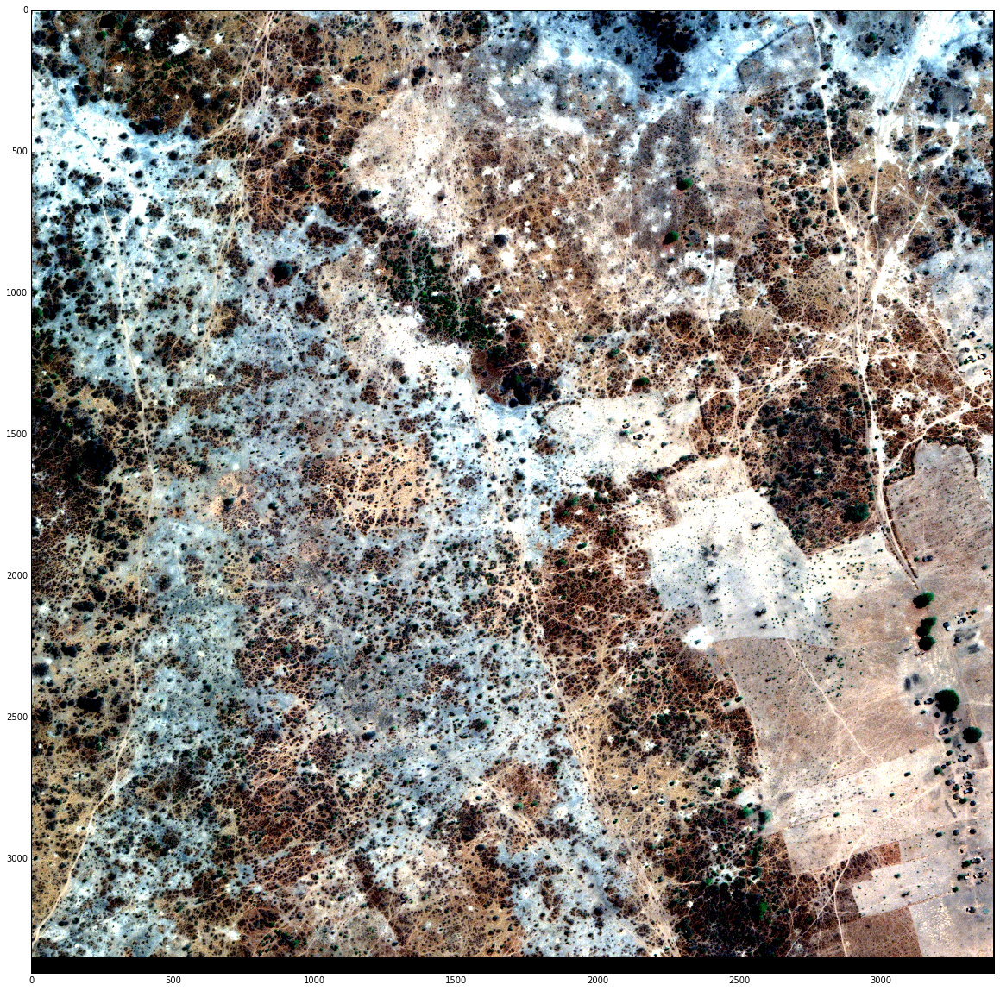

In [3]:
# check input image quaility
plt.imshow(x[0,:,:,:])
plt.show()

In [4]:
class DataGenerator:
    #https://stackoverflow.com/questions/46271896/how-to-use-keras-imagedatagenerator-for-image-transformation-inputs
    def _create_gens(self, data, seed):
        gen_args = dict(
            #featurewise_center=True,
            #featurewise_std_normalization=True,
            rotation_range=45,
            width_shift_range=0.2,
            height_shift_range=0.2,
            shear_range=0.2,
            zoom_range=0.1,
            vertical_flip=True,
            horizontal_flip=True,
            fill_mode="constant",
            cval=0.0)

        gens = []

        for i in range(data.shape[3]):
            shape = data.shape[0:3] + (1,)
            select = data[:,:,:,i].reshape(shape)

            gen = keras.preprocessing.image.ImageDataGenerator(**gen_args)
            gen.fit(select, augment=True, seed=seed)

            gens.append(gen)
            
        return gens
    
    # transforms flowing out of the generators.. 
    def _transform(self,
                   gens,
                   data,
                   add_noise=True,
                   seed=1):

        # note on the shape - data is multiple images bt keras will randomly select one and transform it (due to batch_size=1)
        transform_shape = data.shape[1:4]
        transform = np.zeros(transform_shape, dtype=np.float)

        shape = data.shape[0:3] + (1,)

        for i in range(len(gens)):
            # crazyness with ImageDataGenerator.. im using the single channel(greyscale) tansformer
            select = data[:,:,:,i].reshape(shape)

            # note on the batch size of 1.. images are large.. im going to chop them to bits so lets not queue up to much.. 
            # note on the seed.. we must force it so sync all the transforms for all the channels 
            itr = gens[i].flow(select,batch_size=1,seed=seed)
            d = itr.next()

            # almost human invisiable random noise injection
            transform[:,:,i] = d.reshape(transform_shape[0:2])
            #if add_noise:
            #    noise = (np.random.random(transform_shape[0:2]) - 0.5) / 128.0
            #    transform[:,:,i] += noise
                
        return transform

    # patchs choosen from the transformed image stack
    def _select_patches(self,
                    data_in,   data_out,
                    patches_in,patches_out,
                    offset,    size):
        xmax = data_in.shape[0] - self.patch_size
        ymax = data_in.shape[1] - self.patch_size

        # because of random noise.. 
        noise_threshold = self.patch_size*self.patch_size*self.data_in.shape[3] / 128.0

        # make random patch selections into generated dataset...
        idx = 0
        while idx < size:
            xstart = np.random.randint(xmax)
            ystart = np.random.randint(ymax)

            patches_in [offset+idx] = data_in [xstart:(xstart + self.patch_size), ystart:(ystart + self.patch_size),:]
            patches_out[offset+idx] = data_out[xstart:(xstart + self.patch_size), ystart:(ystart + self.patch_size),:]
            
            # reject the image if there isnt sufficent data in it 
            # ie if it has less than 100 pixels colored in all inputs repeat the selection
            if np.sum(patches_in[offset+idx]) > noise_threshold:
                idx = idx + 1
                
    def __init__(self, 
                 data_in, data_out,
                 patchs_per_transform = 50,
                 patch_size           = 200):
        self.data_in  = data_in
        self.data_out = data_out

        seed = 1
        self.gen_in  = self._create_gens(data_in,  seed)
        self.gen_out = self._create_gens(data_out, seed)

        self.patchs_per_transform = patchs_per_transform
        self.patch_size           = patch_size

    def __call__(self, epochs, samples):
        patches_in  = np.zeros((samples,self.patch_size,self.patch_size,self.data_in.shape[3]),  dtype=np.float)
        patches_out = np.zeros((samples,self.patch_size,self.patch_size,self.data_out.shape[3]), dtype=np.float)

        for i in range(epochs):
            seed  = np.random.randint(65000)
            offset = 0
            count  = samples

            while count > 0:
                # transform a new image 
                transform_in  = self._transform(self.gen_in,  self.data_in,  add_noise=True,  seed=(seed + count))
                transform_out = self._transform(self.gen_out, self.data_out, add_noise=False, seed=(seed + count))

                # extract patches from transformed image
                patch_size = min(self.patchs_per_transform, count)
                self._select_patches(transform_in, transform_out, 
                                     patches_in, patches_out,
                                     offset, patch_size)

                count  = count  - patch_size
                offset = offset + patch_size
            yield patches_in, patches_out

In [5]:
gen = DataGenerator(#x[0:1,:,:,:],y[0:1,:,:,:],
                x,y,
                patchs_per_transform = 20,
                patch_size           = 200)

/usr/local/lib/python2.7/dist-packages/keras/preprocessing/image.py:648: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (25, 3403, 3403, 1) (1 channels).
  ' (' + str(x.shape[self.channel_axis]) + ' channels).')


step...
shapes: (40, 200, 200, 3) (40, 200, 200, 1)


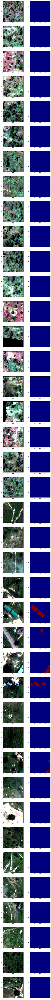

step...
shapes: (40, 200, 200, 3) (40, 200, 200, 1)


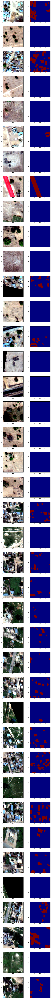

step...
shapes: (40, 200, 200, 3) (40, 200, 200, 1)


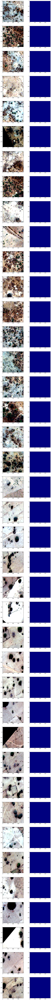

In [25]:
for patches_in, patches_out in gen(epochs=3, samples=40):
    print "step..."
    print "shapes:", patches_in.shape, patches_out.shape
    #cols = patches_in.shape[3] + patches_out.shape[3]
    cols = 1 + patches_out.shape[3]
    rows = patches_in.shape[0]
    
    fig, axArr = plt.subplots(figsize=(5*cols, 5*rows), nrows=rows, ncols=cols)  
    for i in range(rows):
        #for j in range(patches_in.shape[3]):
        #    axArr[i][j].imshow(patches_in[i,:,:,j])
        axArr[i][0].imshow(patches_in[i,:,:,:])

        for j in range(patches_out.shape[3]):
            #k = j + patches_in.shape[3]
            k = j + 1
            axArr[i][k].imshow(patches_out[i,:,:,j])
    plt.show()

In [ ]:
# mask to binay check

In [7]:
itr = gen(epochs=1, samples=40)
patches_in, patches_out = itr.next()

In [8]:
print patches_out.shape

(40, 200, 200, 1)


In [24]:
%%timeit
np.sum(np.sum(np.sum(patches_out, axis=3), axis=2), axis=1)

100 loops, best of 3: 2.62 ms per loop


In [26]:
%%timeit
np.sum(patches_out.reshape((patches_out.shape[0],np.prod(patches_out.shape[1:]))), axis=1) 

1000 loops, best of 3: 636 µs per loop


In [28]:
(np.sum(patches_out.reshape((patches_out.shape[0],np.prod(patches_out.shape[1:]))), axis=1) > 0.0) * 1.0

array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  1.,
        1.,  1.,  0.,  0.,  1.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.])

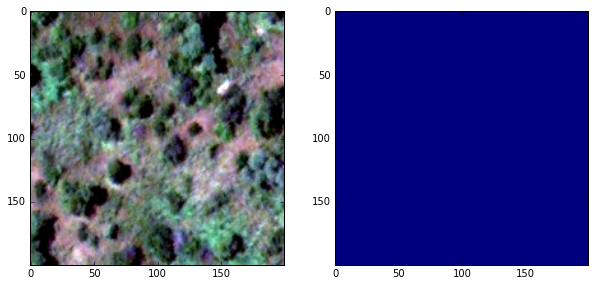

0.0


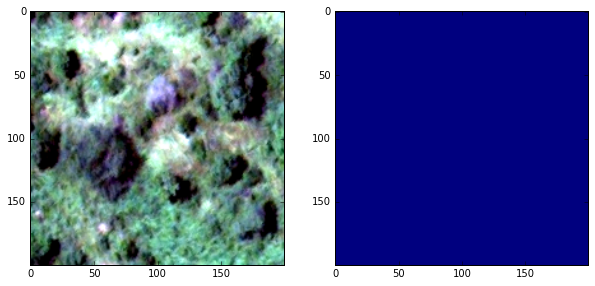

0.0


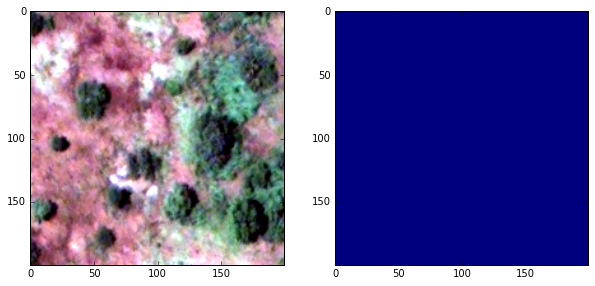

0.0


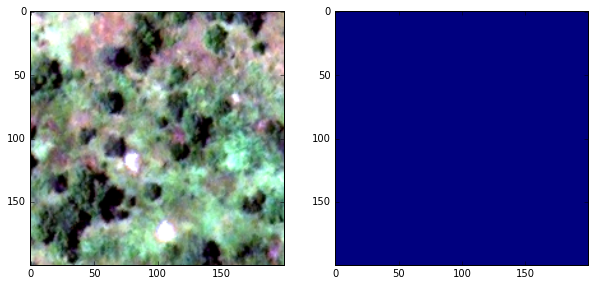

0.0


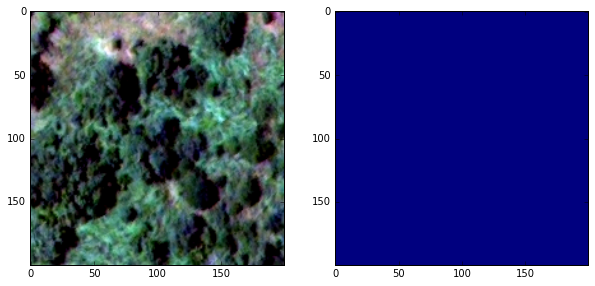

0.0


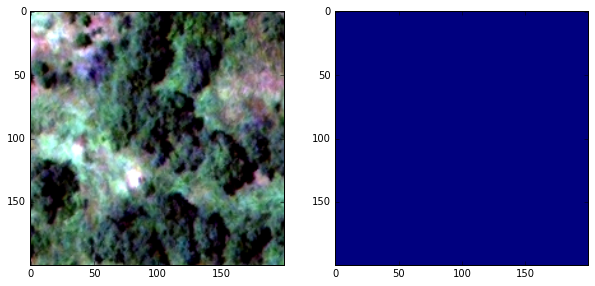

0.0


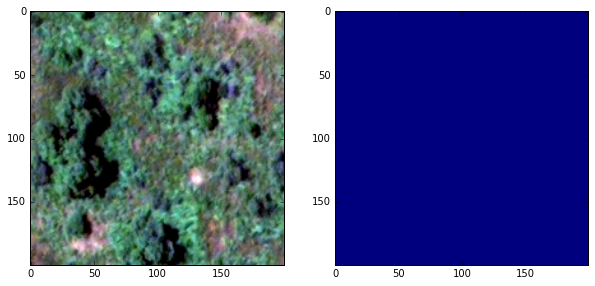

0.0


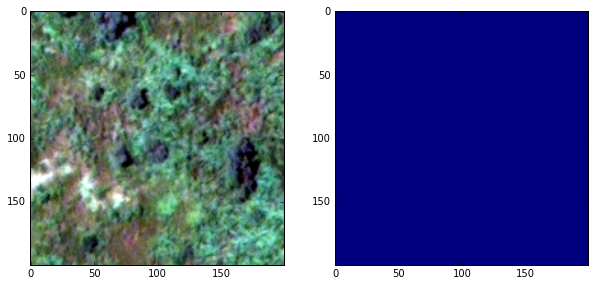

0.0


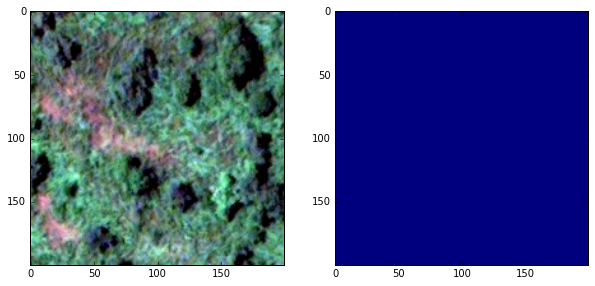

0.0


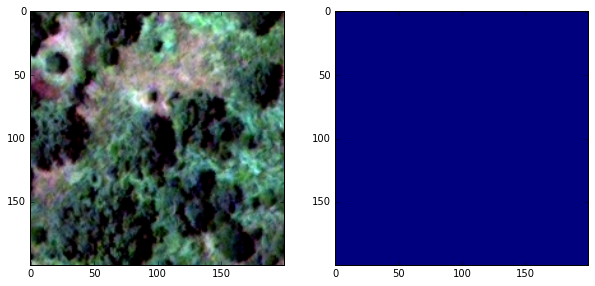

0.0


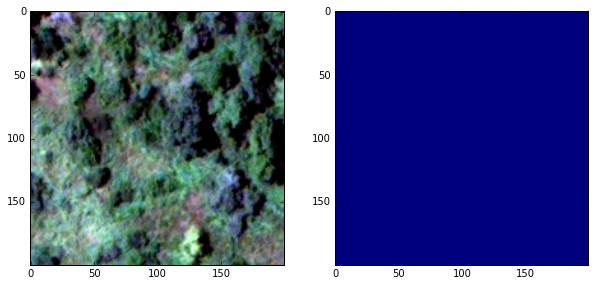

0.0


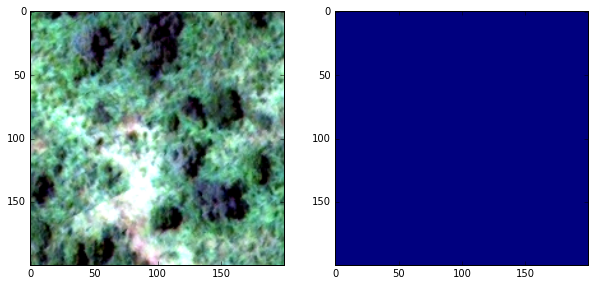

0.0


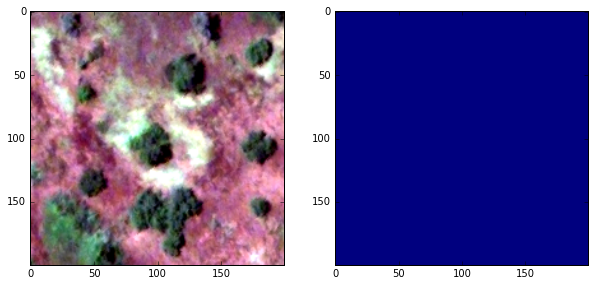

0.0


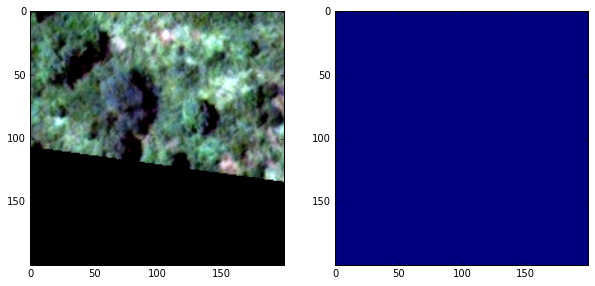

0.0


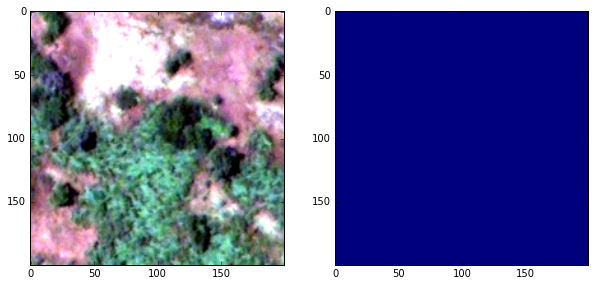

0.0


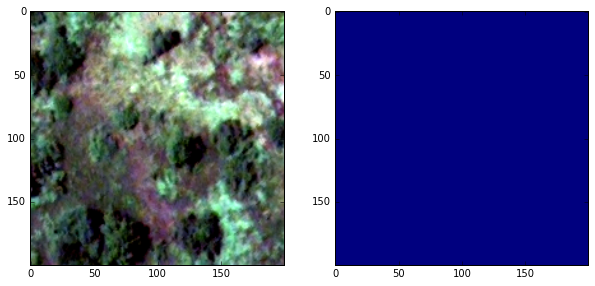

0.0


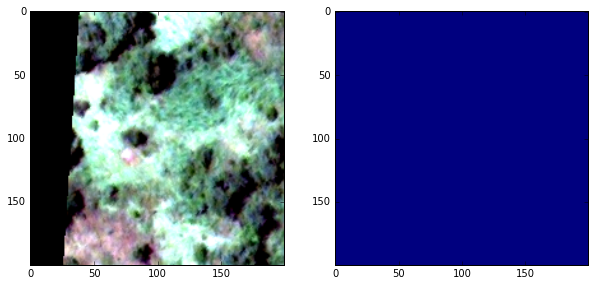

0.0


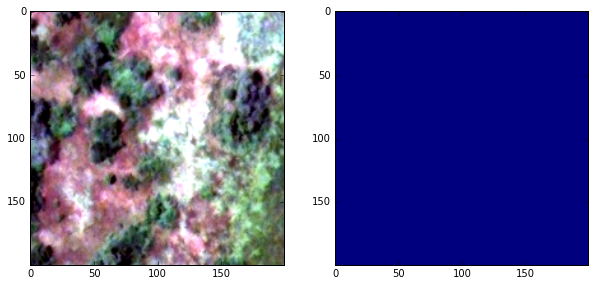

0.0


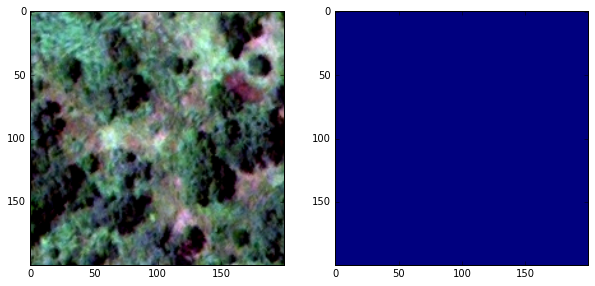

0.0


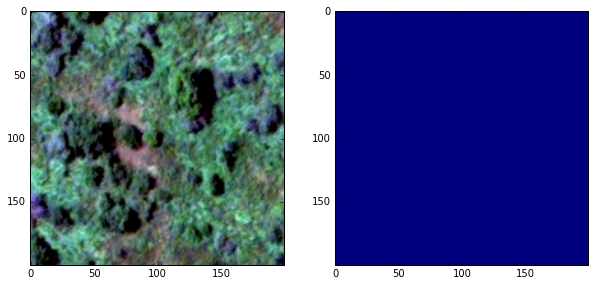

0.0


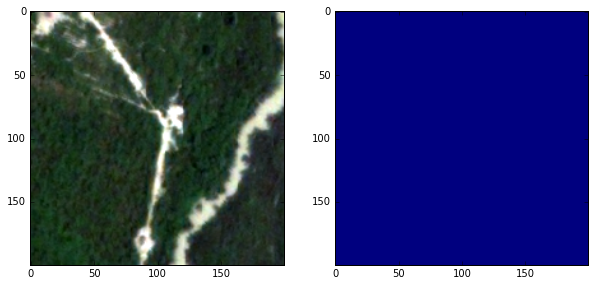

0.0


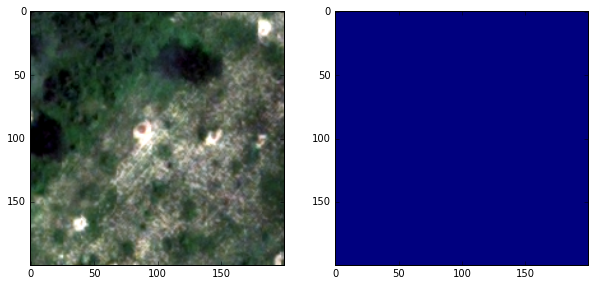

0.0


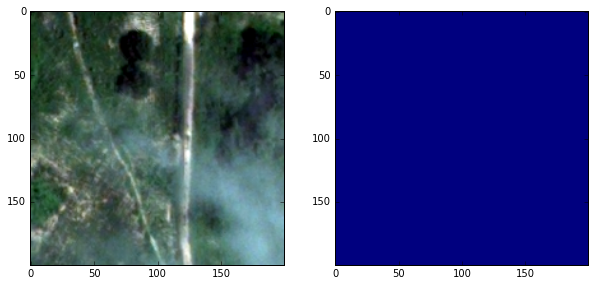

0.0


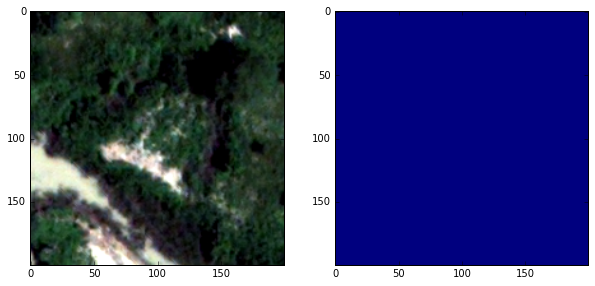

0.0


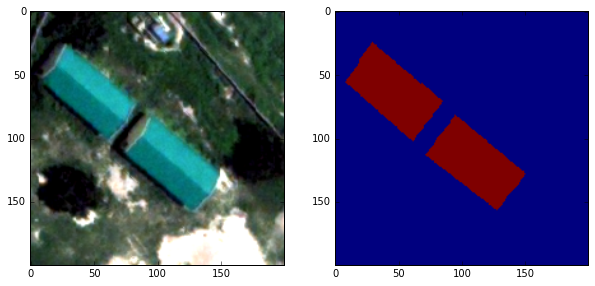

1.0


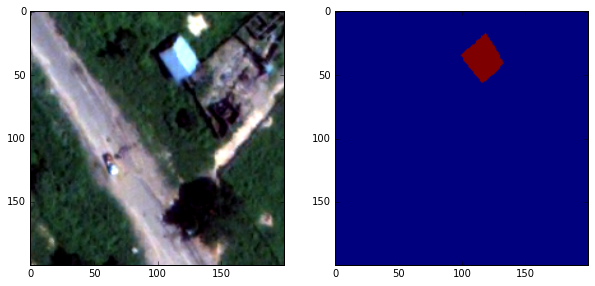

1.0


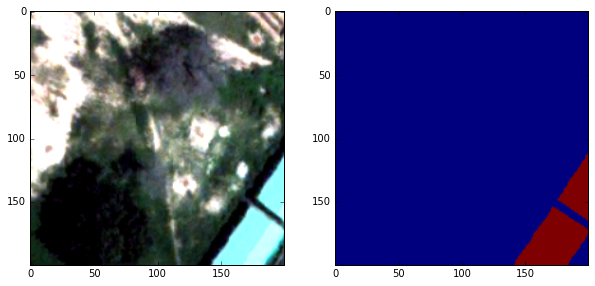

1.0


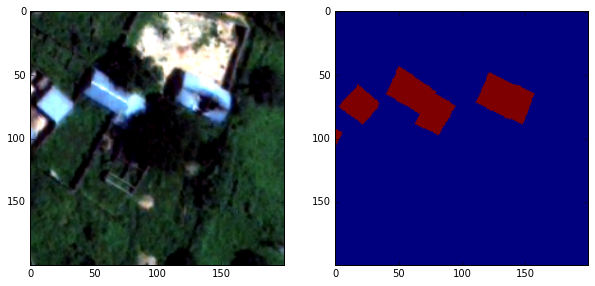

1.0


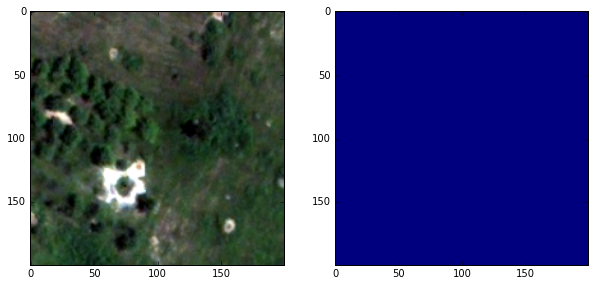

0.0


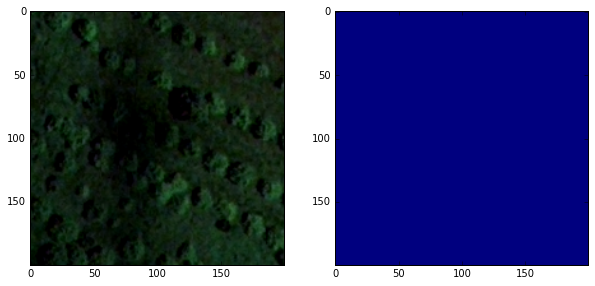

0.0


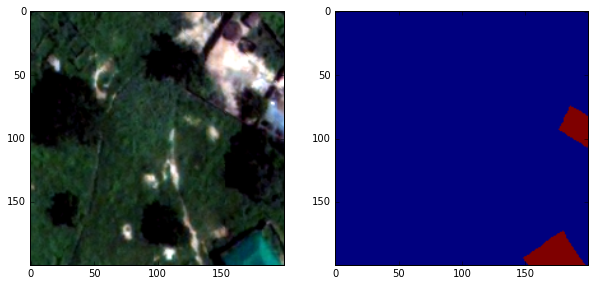

1.0


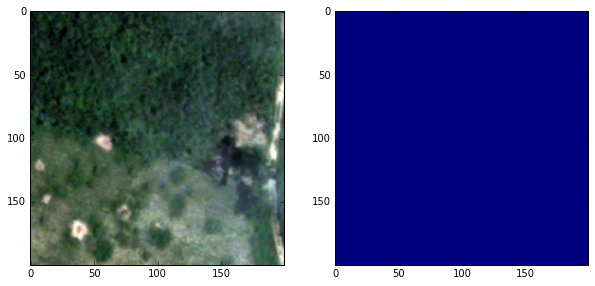

0.0


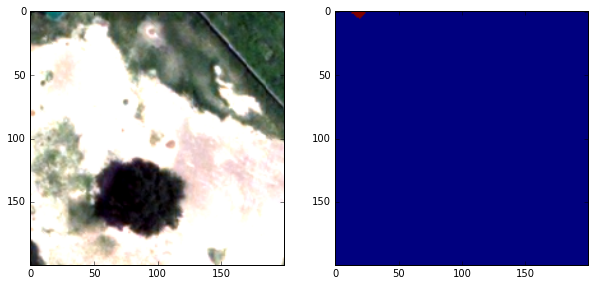

1.0


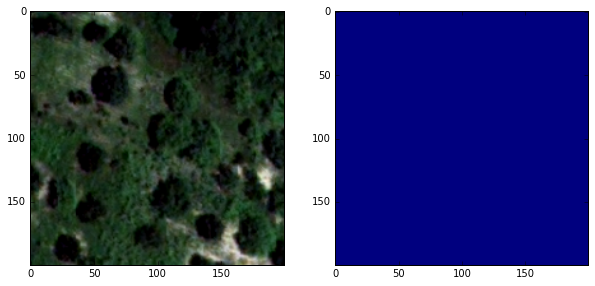

0.0


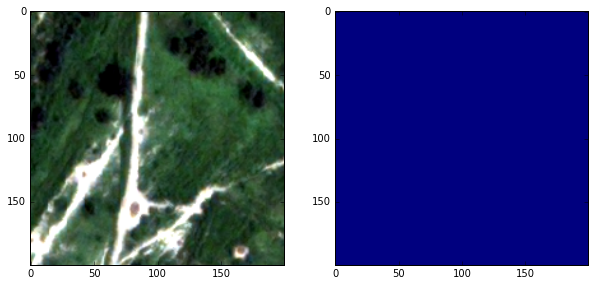

0.0


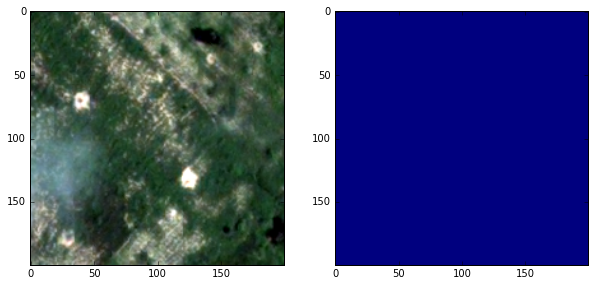

0.0


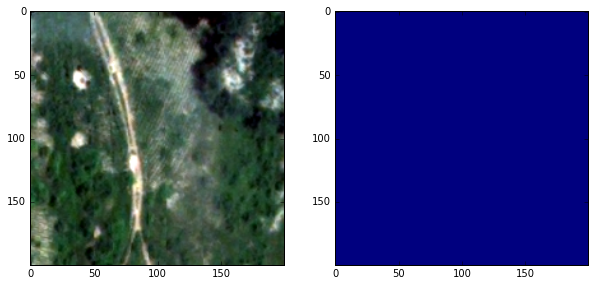

0.0


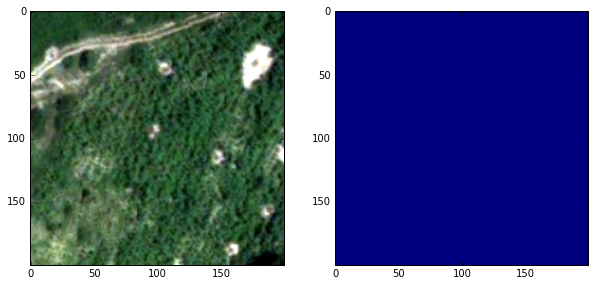

0.0


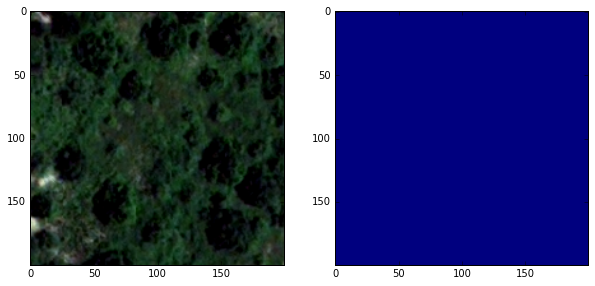

0.0


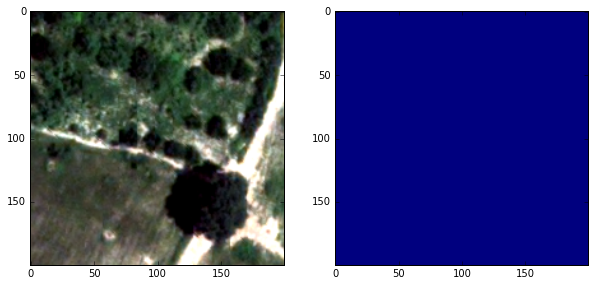

0.0


In [29]:
cols = 1 + patches_out.shape[3]
rows = patches_in.shape[0]
roi = (np.sum(patches_out.reshape((patches_out.shape[0],np.prod(patches_out.shape[1:]))), axis=1) > 0.0) * 1.0

for i in range(rows):
    #for j in range(patches_in.shape[3]):
    #    axArr[i][j].imshow(patches_in[i,:,:,j])
    fig, axArr = plt.subplots(figsize=(5*cols, 5), nrows=1, ncols=cols)  

    axArr[0].imshow(patches_in[i,:,:,:])

    for j in range(patches_out.shape[3]):
        #k = j + patches_in.shape[3]
        k = j + 1
        axArr[k].imshow(patches_out[i,:,:,j])
    plt.show()
    print roi[i]